# Clustering of Facial Embedding Vector
- Embedding vector of face with 128 elements
- BE vs PS debate

In [14]:
# Importing the libraries
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.ticker as mtick
from PIL import Image
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from sklearn.decomposition import PCA


# Importing the data about a specific video in the folder "pkl_files"
data = pd.read_pickle("pkl_files/be-ps.pkl")

# Order the frames by name
data = data.sort_values(by='filename')


# Question: How many distinct faces do we identify throughout the debate?
- Clustering algorithm: Lloyd’s algorithm for k-means
- Let's try to execute this for different number of clusters

In [15]:
# Initialize an empty list to store all embedding vectors
embedding_list = []

# Collect all facial embedding vectors from the 'fer' column of each frame
for i in range(data.shape[0]):
    for fer in data.iloc[i]['fer']:
        embedding_list.append(fer['embedding'])

# Convert the list of embeddings into a NumPy array
embedding_array = np.array(embedding_list)

for i in range(1, 11):
    # Define the number of clusters (PNS, Montenegro, TV Host, Sign Language Interpreter)
    num_clusters = i

    # Apply K-means clustering
    kmeans = KMeans(n_clusters=num_clusters)
    cluster_labels = kmeans.fit_predict(embedding_array)

    # Count the number of faces in each cluster and print in order of cluster number
    cluster_counts = Counter(cluster_labels)
    for cluster in range(num_clusters):
        print(f"{cluster}: {cluster_counts[cluster]}   ", end="")
    print("")
    


        

0: 5639   
0: 3464   1: 2175   
0: 2127   1: 1352   2: 2160   
0: 1936   1: 2160   2: 868   3: 675   
0: 338   1: 2160   2: 863   3: 1910   4: 368   
0: 686   1: 877   2: 753   3: 2092   4: 699   5: 532   
0: 365   1: 754   2: 736   3: 1355   4: 855   5: 875   6: 699   
0: 696   1: 1352   2: 608   3: 757   4: 853   5: 331   6: 736   7: 306   
0: 756   1: 686   2: 319   3: 805   4: 1353   5: 319   6: 753   7: 247   8: 401   
0: 244   1: 1304   2: 470   3: 448   4: 765   5: 321   6: 687   7: 673   8: 306   9: 421   


# Hyphotesis formulation

1. 
- We expect optimal results for 4 clusters, since we have Mortagua, PNS, TV host and sign language interpreter as main protagonists.
- From prior knowledge and previous tests, we know that PNS and Mortagua have a similar speaking time, and they appear on screen a similar amount of time.
- The person who appears the most is the sign language interpreter: almost entirely throughout the whole debate.
- The person who appears less times is the TV host

2. Considering this previous notes, the results for 4 clusters (let's consider this amount from now on) show us that:
- The number of identified faces in ech cluster changes from run to run.
- This means we're having trouble defining the clusters and we strongly depend on centroid initialization.

3. Let's compute a dimensionality reduction (using PCA) for 2D and plot data points with cluster color to check the results.

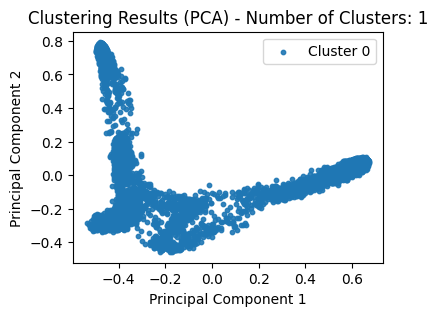

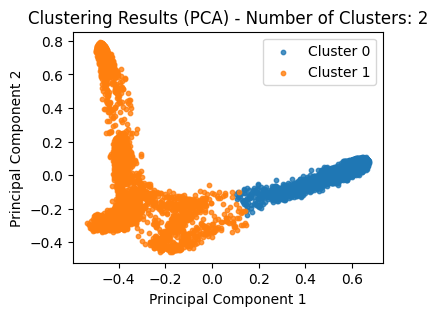

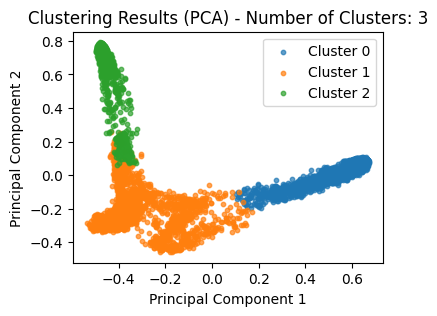

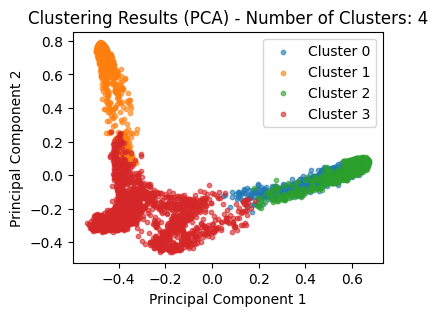

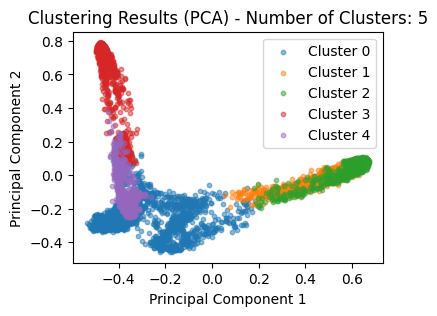

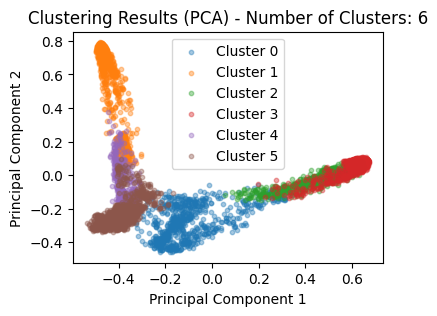

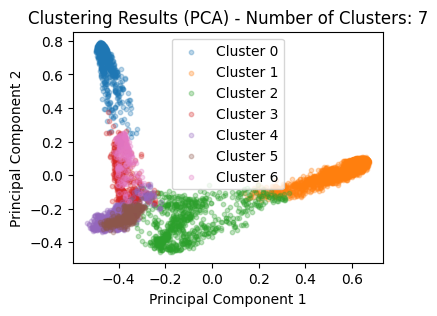

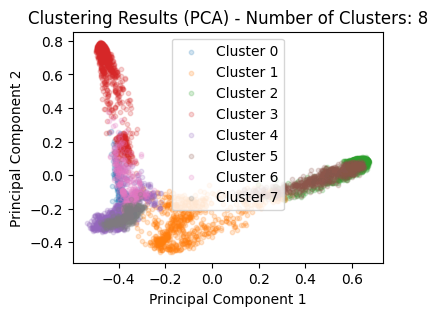

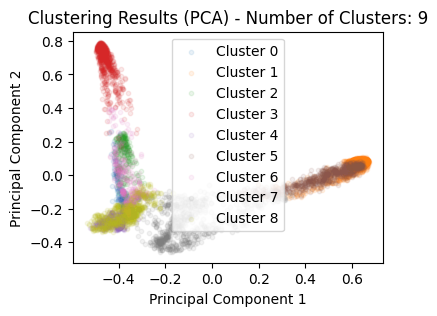

In [16]:
# Define the number of clusters
for i in range(1, 10):
    # Define the number of clusters 
    num_clusters = i

    # Apply K-means clustering
    kmeans = KMeans(n_clusters=num_clusters)
    cluster_labels = kmeans.fit_predict(embedding_array)

    # Reduce the dimensionality of the embedding vectors using PCA
    pca = PCA(n_components=2)  # Reduce to 2 dimensions for visualization
    embedding_pca = pca.fit_transform(embedding_array)

    # Plot clusters in 2D space after PCA
    plt.figure(figsize=(4, 3))
    for i in range(num_clusters):
        plt.scatter(embedding_pca[cluster_labels == i, 0], embedding_pca[cluster_labels == i, 1], label=f'Cluster {i}', alpha=1-num_clusters*0.1, s=10)
    plt.title('Clustering Results (PCA) - Number of Clusters: ' + str(num_clusters))
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.legend()
    plt.show() 

# Hyphotesis formulation

1. By looking at the plots we can immediately exclude scenarios of 5+ faces due to point overlapping. Naturally, 1 or 2 cluster scenario do not make sense considering prior knowledge of the debate nature.

2. For 3 and 4, clusters the results are considerably better, although there is some overlapping in the latter. We also must remember that this plots vary from run to run, since the first centroid initialization in Lloyid K-means algorithm is random (within the dataset).

3. Let's try to check the actual faces identified in the clusters

img00101.jpeg


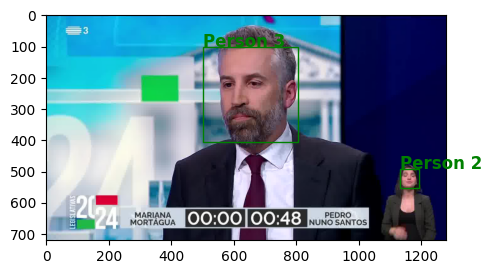

img00201.jpeg


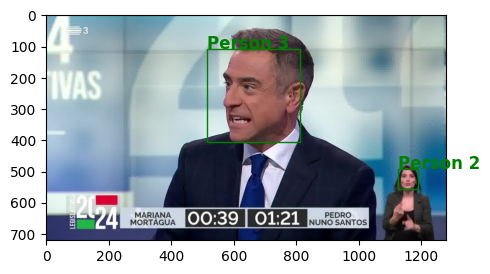

img00301.jpeg


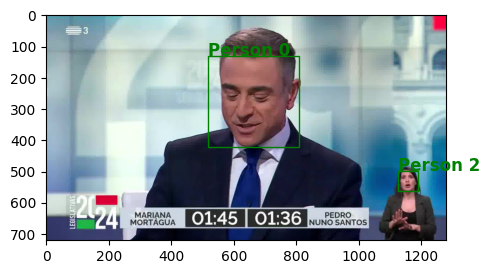

img00401.jpeg


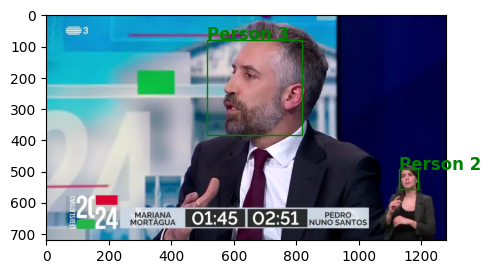

img00501.jpeg


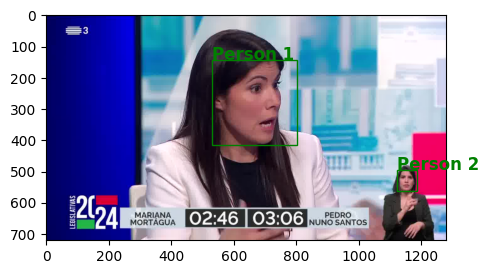

img00601.jpeg


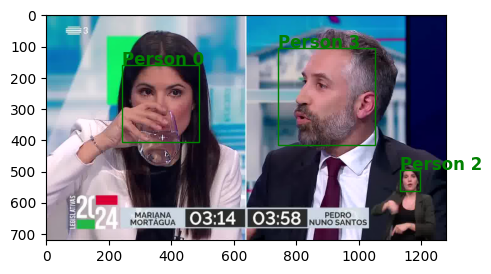

img00701.jpeg


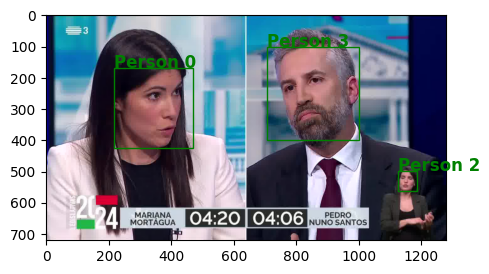

img00801.jpeg


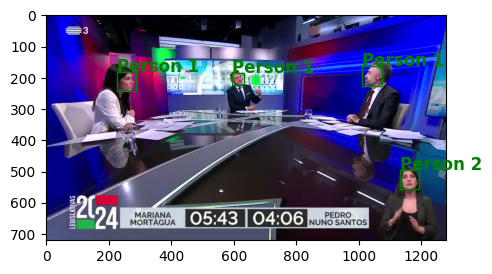

img00901.jpeg


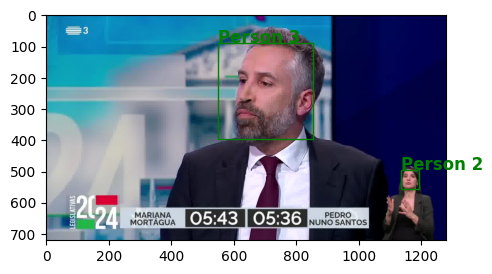

img01001.jpeg


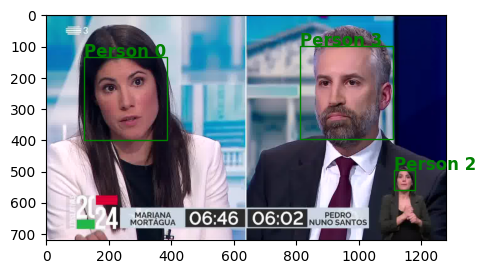

img01101.jpeg


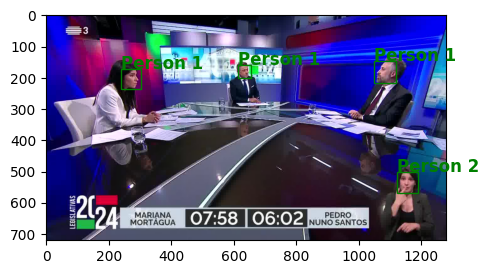

img01201.jpeg


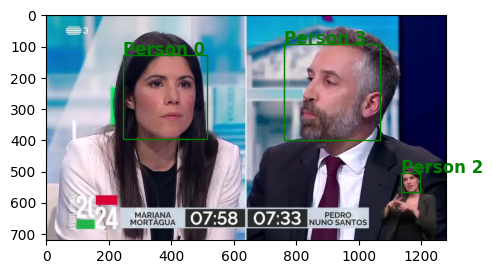

img01301.jpeg


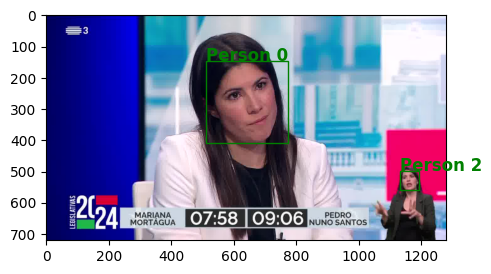

img01401.jpeg


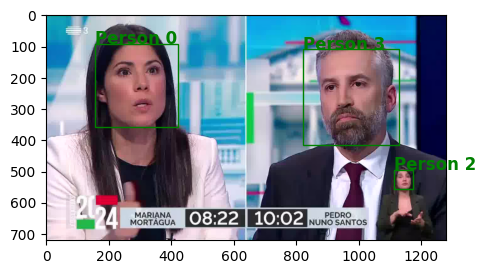

img01501.jpeg


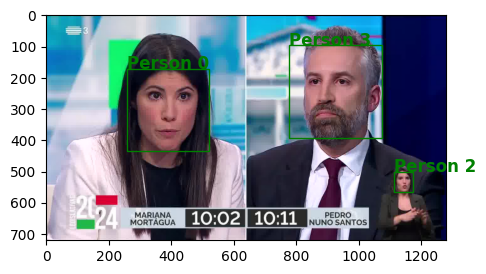

img01601.jpeg


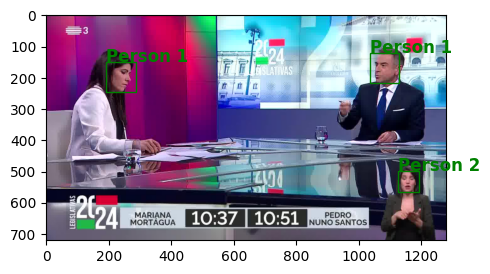

img01701.jpeg


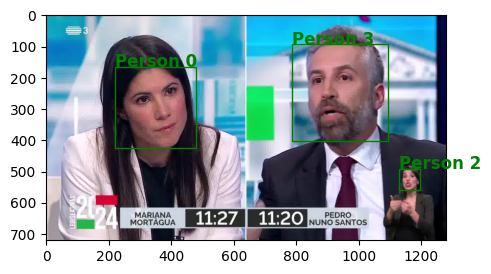

img01801.jpeg


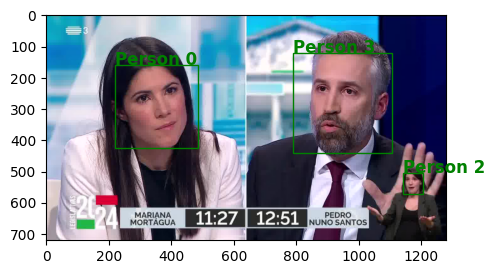

img01901.jpeg


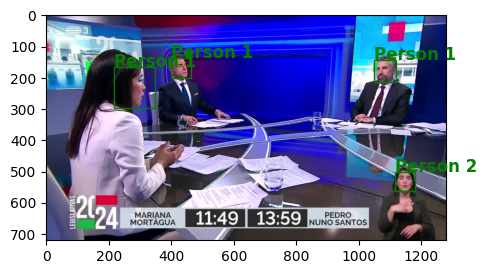

img02001.jpeg


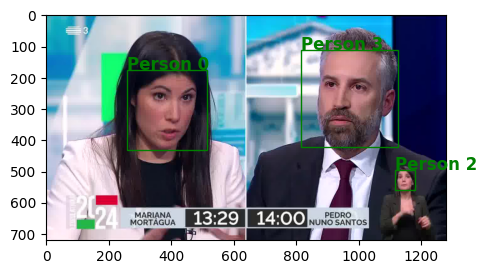

img02101.jpeg


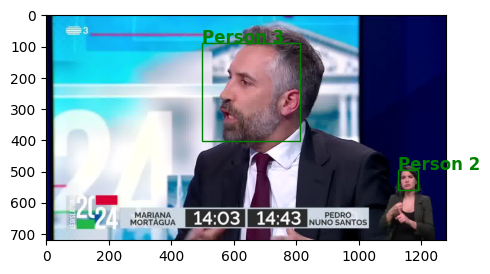

img02201.jpeg


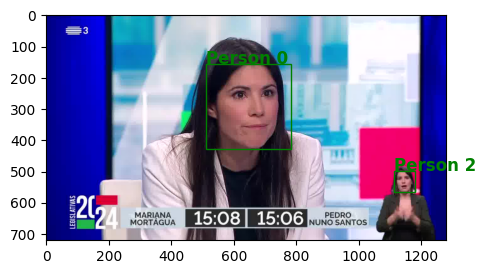

In [18]:
# Apply K-means clustering for 4 clusters (again)
kmeans = KMeans(n_clusters=4)
cluster_labels = kmeans.fit_predict(embedding_array)

# Create a dictionary to match cluster number to person name
cluster_to_person = {
    0: 'Person 0',
    1: 'Person 1',
    2: 'Person 2',
    3: 'Person 3'
}

# Iterate through each frame in the dataset
for i in range(data.shape[0]):
    # Decide which frames to plot (one frame every 100 frames)
    if i % 100 == 0 and i > 0:
        # Plot frame image
        print(data.iloc[i]['filename'])
        img = Image.open(os.path.join('be-ps', data.iloc[i]['filename']))

        # Create a figure and axes
        fig = plt.figure(figsize=(4, 3))
        ax = fig.add_axes([0, 0, 1, 1])
        ax.imshow(img)

        # Iterate through each face in the frame
        for fer in data.iloc[i]['fer']:

            # Extract the bounding box coordinates
            x = fer['location'][0]
            y = fer['location'][2]
            width = fer['location'][1] - fer['location'][0]
            height = fer['location'][3] - fer['location'][2]

            # Create a rectangle patch
            rect = patches.Rectangle((x, y), width, height, linewidth=1, edgecolor='g', facecolor='none')

            # Add patch to the image
            ax.add_patch(rect)
            
            # Look for embedding vector of the face in embedding_array
            embedding = fer['embedding']
            embedding_index = np.where((embedding_array == embedding).all(axis=1))[0][0]

            # Look for cluster number of the face in Çcluster_labels
            cluster_number = cluster_labels[embedding_index]

            # Look for person name of the cluster number in cluster_to_person
            person_name = cluster_to_person[cluster_number]
            ax.text(x, y, person_name, color='g', fontsize=12, fontweight='bold')

        # Display the image with bounding boxes and person names
        plt.show()


# Comments

- The sign language interpreter seems to be correctly labeled, which is good.

- The other 3 clusters seem mixed, or at least they are not divided by person identity.

- This gives us something, but let's print a lot more faces, divided by cluster, to try to find patterns.

# Person 0


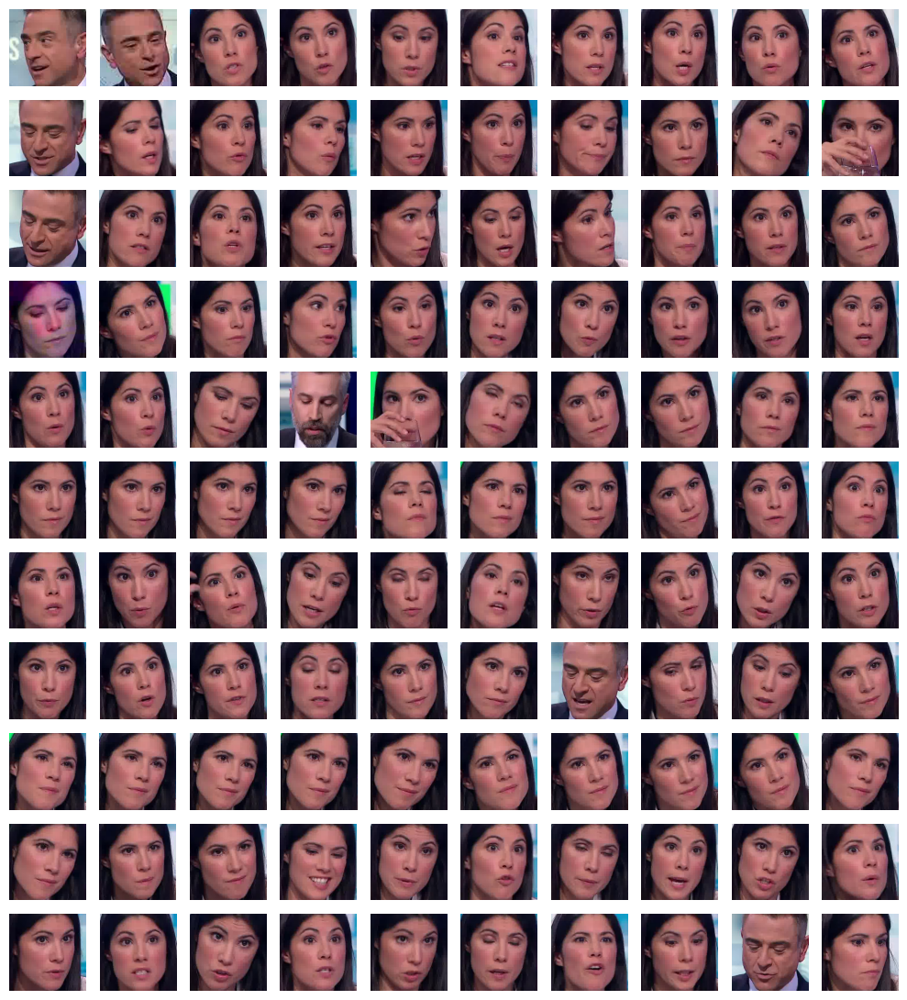

# Person 1


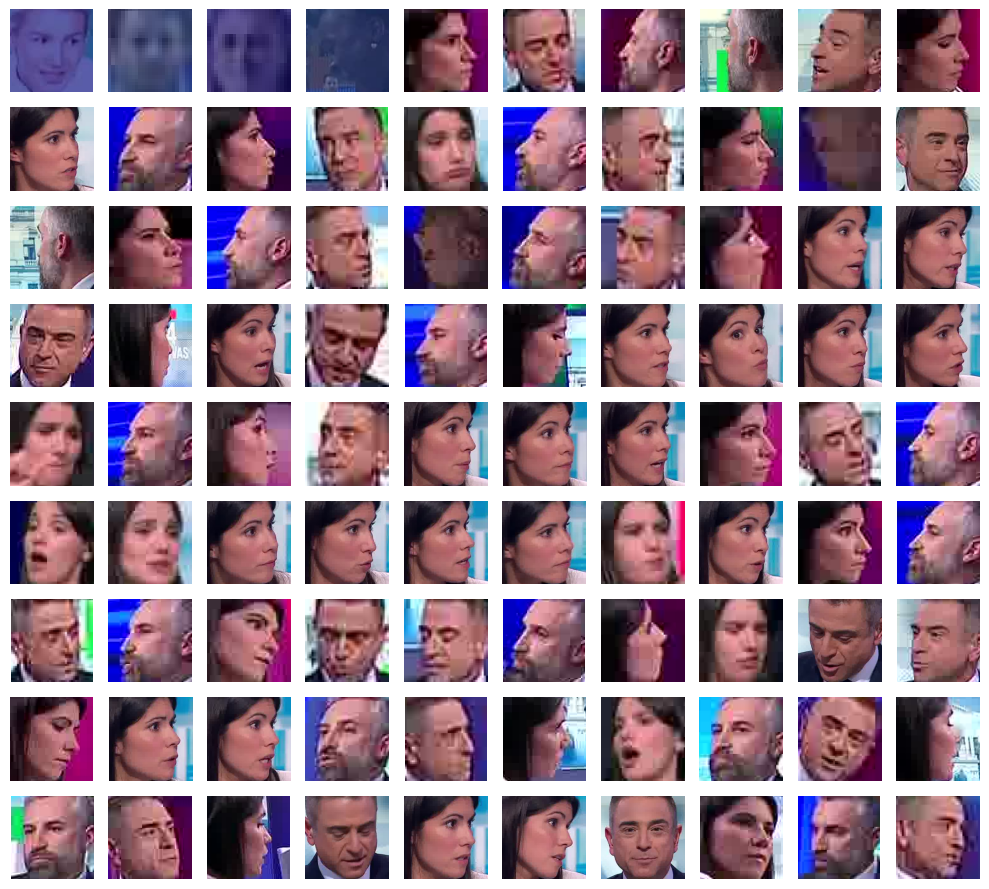

# Person 2


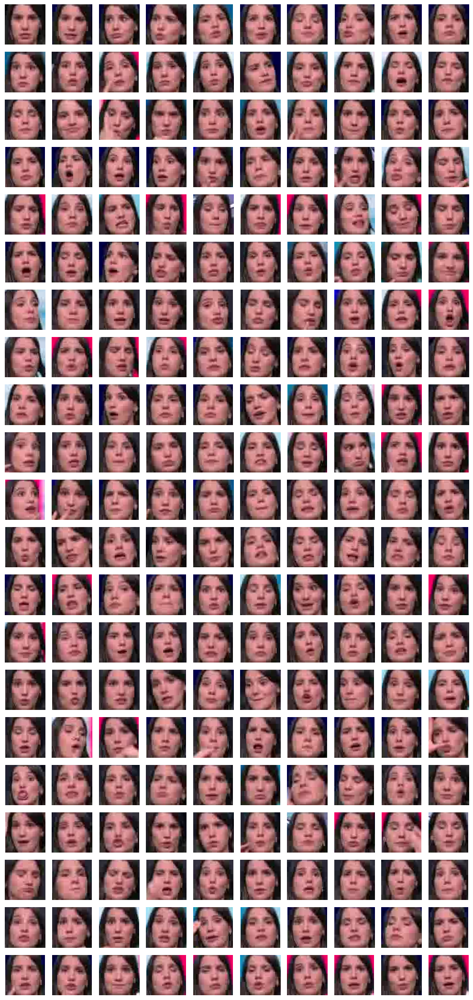

# Person 3


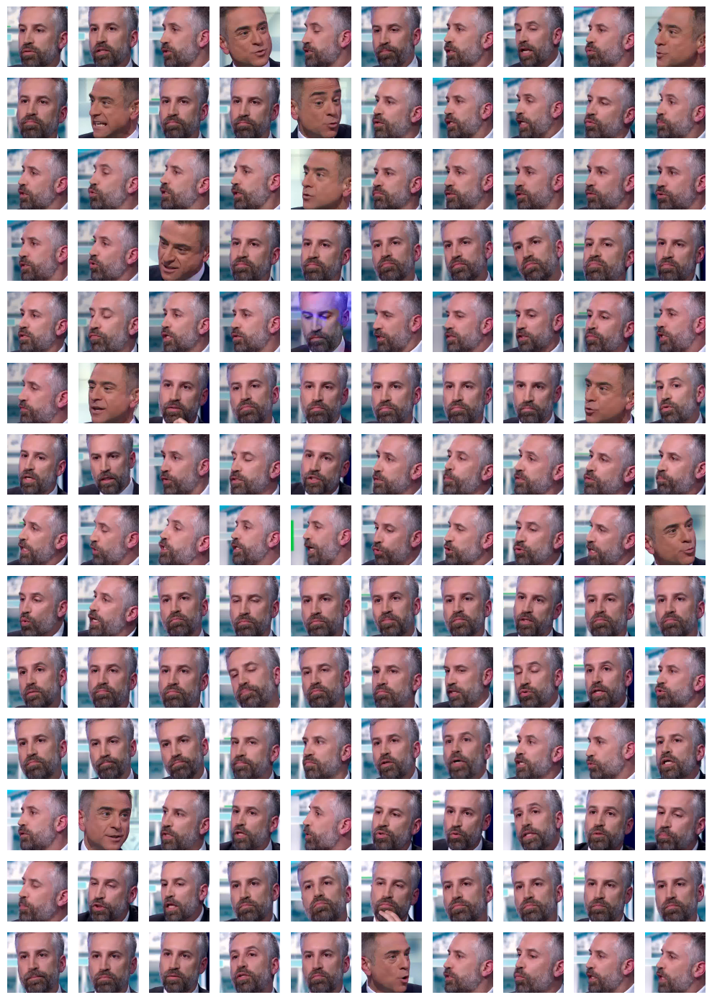

In [19]:
# Create a dictionary to match cluster number to person name
cluster_to_person = {
    0: 'Person 0',
    1: 'Person 1',
    2: 'Person 2',
    3: 'Person 3'
}

# Create a dictionary to store the faces for each person
faces_by_person = {person: [] for person in cluster_to_person.values()}

# Iterate through each frame in the dataset
for i in range(data.shape[0]):
    # Decide which frames to plot (one frame every 10 frames)
    if i % 10 == 0:
        # Iterate through each face in the frame
        for fer in data.iloc[i]['fer']:
            # Look for embedding vector of the face in embedding_array
            embedding = fer['embedding']
            embedding_index = np.where((embedding_array == embedding).all(axis=1))[0][0]

            # Look for cluster number of the face in cluster_labels
            cluster_number = cluster_labels[embedding_index]

            # Look for person name of the cluster number in cluster_to_person
            person_name = cluster_to_person[cluster_number]

            # Add the filename to the face dictionary
            fer['filename'] = data.iloc[i]['filename']

            # Add the face to the corresponding person's list
            faces_by_person[person_name].append(fer)

# Create lists to store the cropped images of each face
cropped_images = []

# Iterate through each person
for person_name, faces in faces_by_person.items():
    print(f"# {person_name}")

    # Iterate through each face
    for fer in faces:
        # Plot frame image
        img = Image.open(os.path.join('be-ps', fer['filename']))

        # Extract the bounding box coordinates
        x = fer['location'][0]
        y = fer['location'][2]
        width = fer['location'][1] - fer['location'][0]
        height = fer['location'][3] - fer['location'][2]

        # Crop the image to the bounding box
        cropped_img = img.crop((x, y, x + width, y + height))

        # Add the cropped image to the list
        cropped_images.append(cropped_img)

    # Determine the number of images and the number of images per row
    num_images = len(cropped_images)
    images_per_row = 10  # Adjust as needed

    # Adjust the number of images to be a multiple of images_per_row
    num_images = (num_images // images_per_row) * images_per_row

    # Determine the number of rows
    num_rows = num_images // images_per_row

    # Create a figure with a subplot for each image
    fig, axs = plt.subplots(num_rows, images_per_row, figsize=(images_per_row, num_rows))  # Adjust size as needed

    # Iterate through each image
    for i, cropped_img in enumerate(cropped_images[:num_images]):
        # Determine the row and column indices of the subplot
        row = i // images_per_row
        col = i % images_per_row

        # Display the cropped image in the corresponding subplot
        axs[row, col].imshow(cropped_img)
        axs[row, col].axis('off')  # Hide axes

    # Display all images
    plt.tight_layout()
    plt.show()

    # Clear the list of cropped images for the next person
    cropped_images.clear()

# Comments

- Sign language interpreter is perfectly identified --> PERSON 2

- PNS is is relatively well identified --> PERSON 3

- Mortagua is is relatively well identified --> PERSON 0

- PERSON 1 seems to gather all identified faces far away from the camera and with reduced visibility

- TV host is not clearly identified and appears in practically every person



# Main conclusion

- In this debate the clustering method works a lot better than in other debates analysed (such as ADvsChega). The main reason might be the physical difference between present people: Mortagua is a woman, PNS a man with a lot of beard. The sign language interpreter remains perfectly identified.

- This means we can use this clustering for generating other graphs, since people identification is resonable enough!!!



# However, let's also try that other approach to possibly discard outliers.

This uses some a priori knowledge:

- The debate itself starts at 40 seconds and finishes at 37 minutes, which means we will discard frames outside that interval.

- On the right bottom corner places the sign language interpreter, which means we don't really need to use clustering to identify her, but only her bounding box coordinates.

- A similar principle applies to when we have 3 or 4 people on frame. Although there might be some exceptions, in this cases, we usually have Mortagua on the left, PNS on the right and the TV host in the middle in 4 people frames (plus the sign language interpreter in the bottom right, naturally)

- This means we can automatically identify the people on frame in those circumstances, using solely the bounding boxes coordinates and the number of people on frame.

- This also means we can reduce the clustering methodology to frames where 2 people appear (being one the sign language interpreter), and differentiate the ones with PNS and Mortagua. So naturally, using K-means for 2 clusters makes sense (in some frames might be the TV host instead of one of the politicians, but the proportion is despicable).

In [27]:
# Initialize an empty list to store all embedding vectors
embedding_list = []

# Intialize empty lists to store the facial embeddings of each person
PNS = []
Mortagua = []
TV_Host = []
Sign_Language_Interpreter = []

# Collect all facial embedding vectors from the 'fer' column of each frame, but only 
for i in range(data.shape[0]):

    # Debate starts at frame 50 and ends at frame 39*60
    if i >= 40  and i <= 37*60: 

        # 4 people on frame
        if len(data.iloc[i]['fer']) == 4: 

            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            Mortagua.append(people[0]['embedding'])
            TV_Host.append(people[1]['embedding'])
            PNS.append(people[2]['embedding'])
            Sign_Language_Interpreter.append(people[3]['embedding'])


        # 3 people on frame
        elif len(data.iloc[i]['fer']) == 3:

            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            Mortagua.append(people[0]['embedding'])
            PNS.append(people[1]['embedding'])
            Sign_Language_Interpreter.append(people[2]['embedding'])


        # 2 people on frame (one is the sign language interpreter)
        elif len(data.iloc[i]['fer']) == 2:
            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            embedding_list.append(people[0]['embedding'])
            Sign_Language_Interpreter.append(people[1]['embedding'])

        # Note: Discard frames with 1 person or 0 people


# Convert the list of embeddings into a NumPy array
embedding_array = np.array(embedding_list)

# Cluster the facial embeddings of each person (PNS and Montenegro)
num_clusters = 2

# Apply K-means clustering
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(embedding_array)

# Print the number of faces in each cluster
cluster_counts = Counter(cluster_labels)
for cluster in range(num_clusters):
    print(f"{cluster}: {cluster_counts[cluster]}   ", end="")
print("")

# Print the number of faces in each other list
print(f"PNS: {len(PNS)}")
print(f"Montenegro: {len(Mortagua)}")
print(f"TV Host: {len(TV_Host)}")
print(f"Sign Language Interpreter: {len(Sign_Language_Interpreter)}")



0: 592   1: 616   
PNS: 944
Montenegro: 944
TV Host: 126
Sign Language Interpreter: 2152


# Now we re-do all the things to validate (or not) this approach

- Plot PCA by cluster
- Plot faces of each cluster

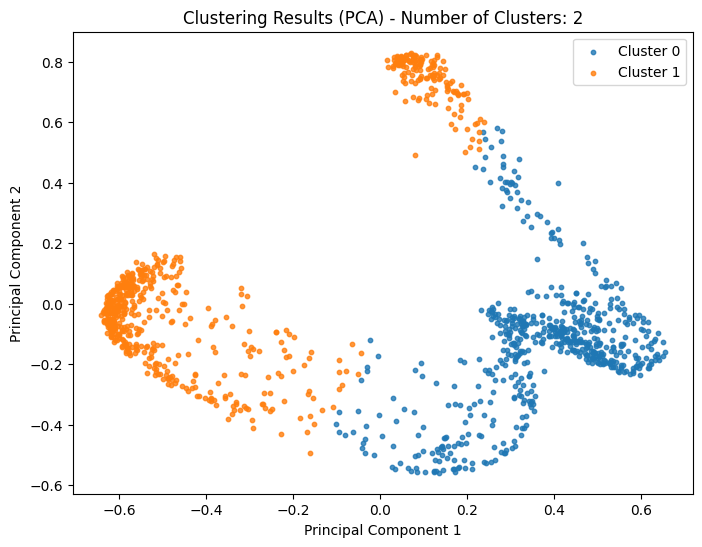

In [28]:
# Reduce the dimensionality of the embedding vectors using PCA
pca = PCA(n_components=2)  # Reduce to 2 dimensions for visualization
embedding_pca = pca.fit_transform(embedding_array)

# Plot clusters in 2D space after PCA
plt.figure(figsize=(8, 6))
for i in range(num_clusters):
    plt.scatter(embedding_pca[cluster_labels == i, 0], embedding_pca[cluster_labels == i, 1], label=f'Cluster {i}', alpha=1-num_clusters*0.1, s=10)
plt.title('Clustering Results (PCA) - Number of Clusters: ' + str(num_clusters))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show() 

# Comments:

- K-means clustering does not seem the best one for this case. 

- Let's stick with this and then we change the clustering method if needed.

# Person 0


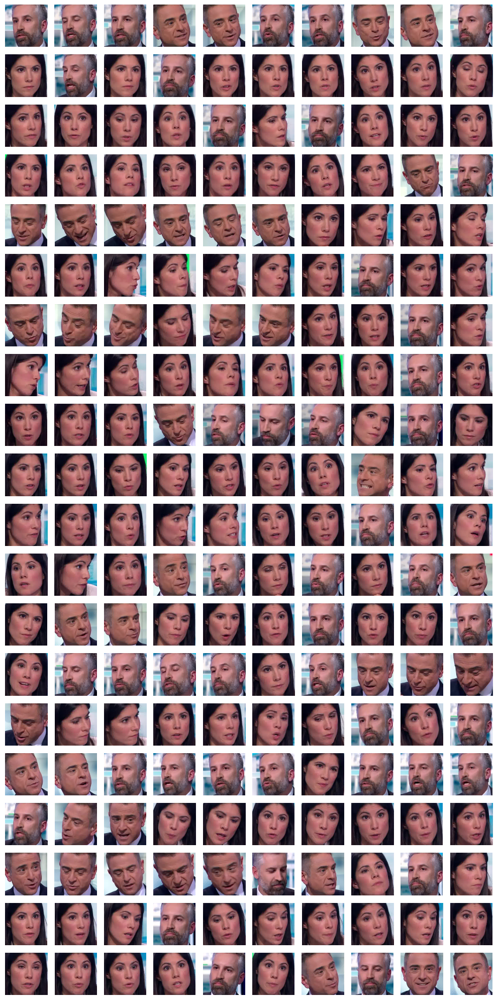

# Person 1


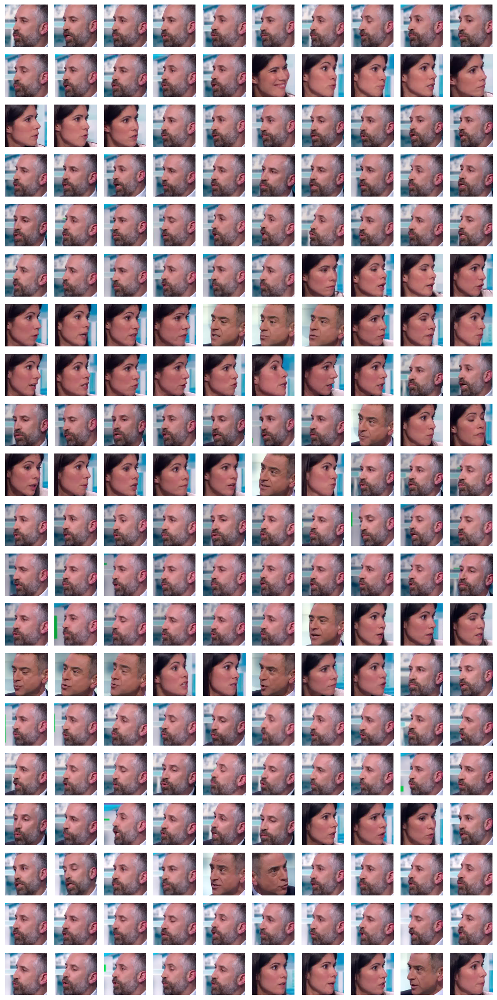

In [30]:
# Create a dictionary to match cluster number to person name
cluster_to_person = {
    0: 'Person 0',
    1: 'Person 1'
}

# Create a dictionary to store the faces for each person
faces_by_person = {person: [] for person in cluster_to_person.values()}

# Iterate through each frame in the dataset
for i in range(data.shape[0]):
    # Decide which frames to plot (one frame every 10 frames)
    if i % 3 == 0 and i >= 50 and i <= 39*60:

        # Only consider 2 faces frames
        if len(data.iloc[i]['fer']) == 2:

            # Iterate through each face in the frame
            for fer in data.iloc[i]['fer']:
                # Look for embedding vector of the face in embedding_array
                embedding = fer['embedding']
                indices = np.where((embedding_array == embedding).all(axis=1))[0]

                # Check if indices is not empty
                if indices.size > 0:
                    embedding_index = indices[0]
                else:
                    continue  # Skip to the next iteration if indices is empty

                # Look for cluster number of the face in cluster_labels
                cluster_number = cluster_labels[embedding_index]

                # Look for person name of the cluster number in cluster_to_person
                person_name = cluster_to_person[cluster_number]

                # Add the filename to the face dictionary
                fer['filename'] = data.iloc[i]['filename']

                # Add the face to the corresponding person's list
                faces_by_person[person_name].append(fer)

# Create lists to store the cropped images of each face
cropped_images = []

# Iterate through each person
for person_name, faces in faces_by_person.items():
    print(f"# {person_name}")

    # Iterate through each face
    for fer in faces:
        # Plot frame image
        img = Image.open(os.path.join('be-ps', fer['filename']))

        # Extract the bounding box coordinates
        x = fer['location'][0]
        y = fer['location'][2]
        width = fer['location'][1] - fer['location'][0]
        height = fer['location'][3] - fer['location'][2]

        # Crop the image to the bounding box
        cropped_img = img.crop((x, y, x + width, y + height))

        # Add the cropped image to the list
        cropped_images.append(cropped_img)

    # Determine the number of images and the number of images per row
    num_images = len(cropped_images)
    images_per_row = 10  # Adjust as needed

    # Adjust the number of images to be a multiple of images_per_row
    num_images = (num_images // images_per_row) * images_per_row

    # Determine the number of rows
    num_rows = num_images // images_per_row

    # Create a figure with a subplot for each image
    fig, axs = plt.subplots(num_rows, images_per_row, figsize=(images_per_row, num_rows))  # Adjust size as needed

    # Iterate through each image
    for i, cropped_img in enumerate(cropped_images[:num_images]):
        # Determine the row and column indices of the subplot
        row = i // images_per_row
        col = i % images_per_row

        # Display the cropped image in the corresponding subplot
        axs[row, col].imshow(cropped_img)
        axs[row, col].axis('off')  # Hide axes

    # Display all images
    plt.tight_layout()
    plt.show()

    # Clear the list of cropped images for the next person
    cropped_images.clear()

# Failure: why?

- Clearly the clustering did not capture the feature we wanted, ie, the identity of people.

- Let's try spectral clustering (considering the PCA representation already obtained)

c:\Users\MCB\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


0: 704   1: 504   
PNS: 944
Montenegro: 944
TV Host: 126
Sign Language Interpreter: 2152


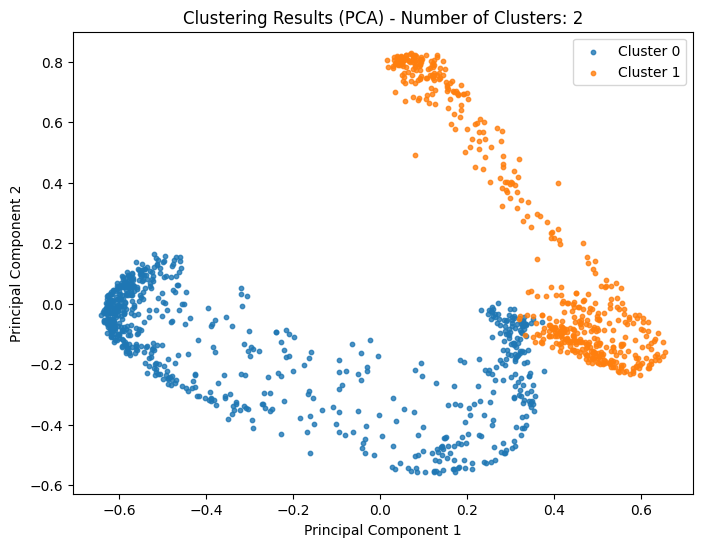

In [39]:
# Initialize an empty list to store all embedding vectors
embedding_list = []

# Intialize empty lists to store the facial embeddings of each person
PNS = []
Mortagua = []
TV_Host = []
Sign_Language_Interpreter = []

# Collect all facial embedding vectors from the 'fer' column of each frame, but only 
for i in range(data.shape[0]):

    # Debate starts at frame 50 and ends at frame 39*60
    if i >= 40  and i <= 37*60: 

        # 4 people on frame
        if len(data.iloc[i]['fer']) == 4: 

            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            Mortagua.append(people[0]['embedding'])
            TV_Host.append(people[1]['embedding'])
            PNS.append(people[2]['embedding'])
            Sign_Language_Interpreter.append(people[3]['embedding'])


        # 3 people on frame
        elif len(data.iloc[i]['fer']) == 3:

            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            Mortagua.append(people[0]['embedding'])
            PNS.append(people[1]['embedding'])
            Sign_Language_Interpreter.append(people[2]['embedding'])


        # 2 people on frame (one is the sign language interpreter)
        elif len(data.iloc[i]['fer']) == 2:
            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            embedding_list.append(people[0]['embedding'])
            Sign_Language_Interpreter.append(people[1]['embedding'])

        # Note: Discard frames with 1 person or 0 people


# Convert the list of embeddings into a NumPy array
embedding_array = np.array(embedding_list)

# Cluster the facial embeddings of each person (PNS and Montenegro)
num_clusters = 2

# Apply spectral clustering
spectral = SpectralClustering(n_clusters=num_clusters, affinity='nearest_neighbors')
cluster_labels = spectral.fit_predict(embedding_array)

# Print the number of faces in each cluster
cluster_counts = Counter(cluster_labels)
for cluster in range(num_clusters):
    print(f"{cluster}: {cluster_counts[cluster]}   ", end="")
print("")

# Print the number of faces in each other list
print(f"PNS: {len(PNS)}")
print(f"Montenegro: {len(Mortagua)}")
print(f"TV Host: {len(TV_Host)}")
print(f"Sign Language Interpreter: {len(Sign_Language_Interpreter)}")

# Reduce the dimensionality of the embedding vectors using PCA
pca = PCA(n_components=2)  # Reduce to 2 dimensions for visualization
embedding_pca = pca.fit_transform(embedding_array)

# Plot clusters in 2D space after PCA
plt.figure(figsize=(8, 6))
for i in range(num_clusters):
    plt.scatter(embedding_pca[cluster_labels == i, 0], embedding_pca[cluster_labels == i, 1], label=f'Cluster {i}', alpha=1-num_clusters*0.1, s=10)
plt.title('Clustering Results (PCA) - Number of Clusters: ' + str(num_clusters))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

# Person 0


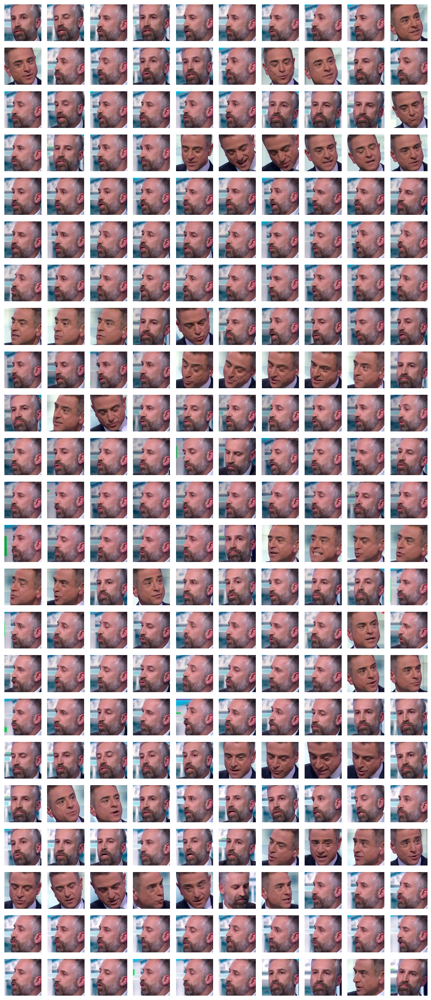

# Person 1


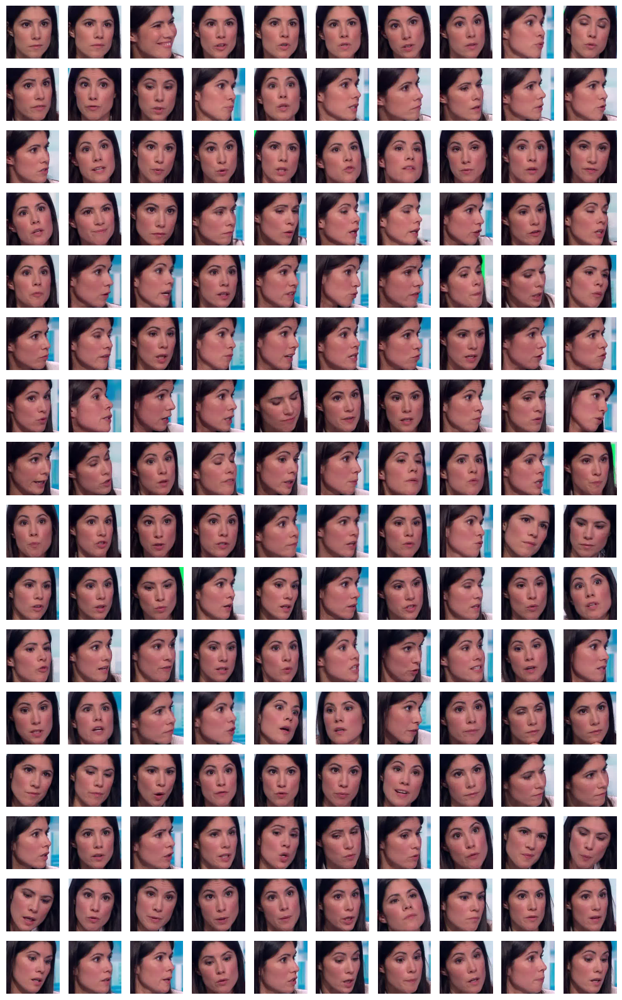

In [40]:
# Create a dictionary to match cluster number to person name
cluster_to_person = {
    0: 'Person 0',
    1: 'Person 1'
}

# Create a dictionary to store the faces for each person
faces_by_person = {person: [] for person in cluster_to_person.values()}

# Iterate through each frame in the dataset
for i in range(data.shape[0]):
    # Decide which frames to plot (one frame every 10 frames)
    if i % 3 == 0 and i >= 50 and i <= 39*60:

        # Only consider 2 faces frames
        if len(data.iloc[i]['fer']) == 2:

            # Iterate through each face in the frame
            for fer in data.iloc[i]['fer']:
                # Look for embedding vector of the face in embedding_array
                embedding = fer['embedding']
                indices = np.where((embedding_array == embedding).all(axis=1))[0]

                # Check if indices is not empty
                if indices.size > 0:
                    embedding_index = indices[0]
                else:
                    continue  # Skip to the next iteration if indices is empty

                # Look for cluster number of the face in cluster_labels
                cluster_number = cluster_labels[embedding_index]

                # Look for person name of the cluster number in cluster_to_person
                person_name = cluster_to_person[cluster_number]

                # Add the filename to the face dictionary
                fer['filename'] = data.iloc[i]['filename']

                # Add the face to the corresponding person's list
                faces_by_person[person_name].append(fer)

# Create lists to store the cropped images of each face
cropped_images = []

# Iterate through each person
for person_name, faces in faces_by_person.items():
    print(f"# {person_name}")

    # Iterate through each face
    for fer in faces:
        # Plot frame image
        img = Image.open(os.path.join('be-ps', fer['filename']))

        # Extract the bounding box coordinates
        x = fer['location'][0]
        y = fer['location'][2]
        width = fer['location'][1] - fer['location'][0]
        height = fer['location'][3] - fer['location'][2]

        # Crop the image to the bounding box
        cropped_img = img.crop((x, y, x + width, y + height))

        # Add the cropped image to the list
        cropped_images.append(cropped_img)

    # Determine the number of images and the number of images per row
    num_images = len(cropped_images)
    images_per_row = 10  # Adjust as needed

    # Adjust the number of images to be a multiple of images_per_row
    num_images = (num_images // images_per_row) * images_per_row

    # Determine the number of rows
    num_rows = num_images // images_per_row

    # Create a figure with a subplot for each image
    fig, axs = plt.subplots(num_rows, images_per_row, figsize=(images_per_row, num_rows))  # Adjust size as needed

    # Iterate through each image
    for i, cropped_img in enumerate(cropped_images[:num_images]):
        # Determine the row and column indices of the subplot
        row = i // images_per_row
        col = i % images_per_row

        # Display the cropped image in the corresponding subplot
        axs[row, col].imshow(cropped_img)
        axs[row, col].axis('off')  # Hide axes

    # Display all images
    plt.tight_layout()
    plt.show()

    # Clear the list of cropped images for the next person
    cropped_images.clear()

# Success!!!!

- When applying spectral embedding to facial embeddings of 2 face frames (one being the sign language interpreter), the algorithm works a lot better.

- Only problem is the TV host appearing in PNS cluster, but that's moreless fine.

- Let's check if our alternative method did a good job (for 3 and 4 faces frames).

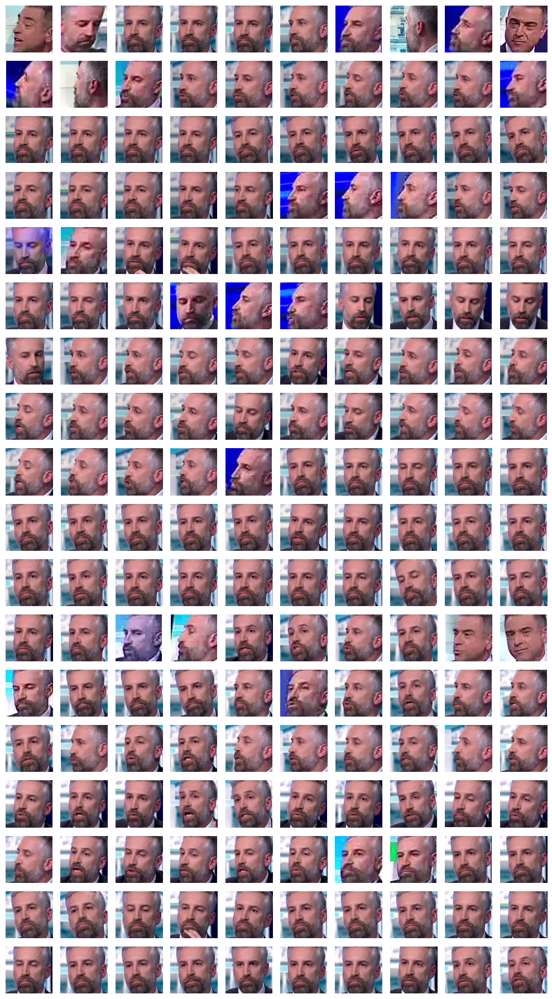

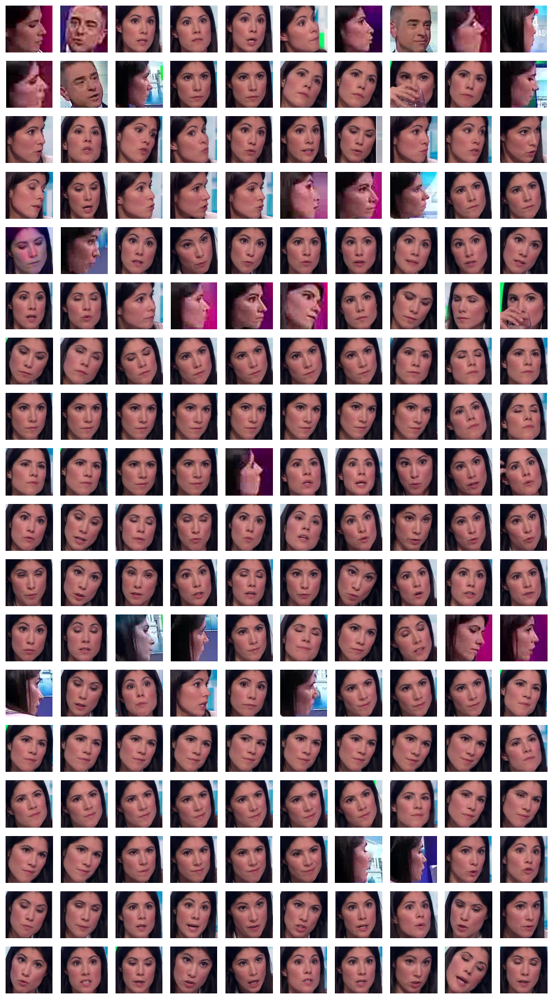

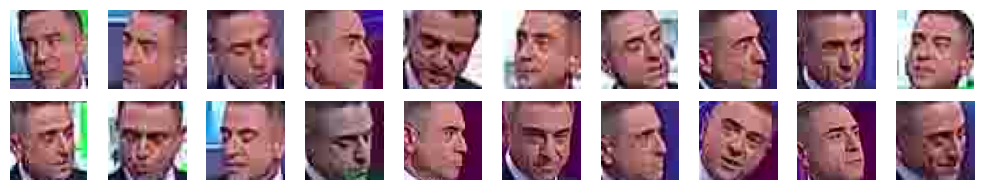

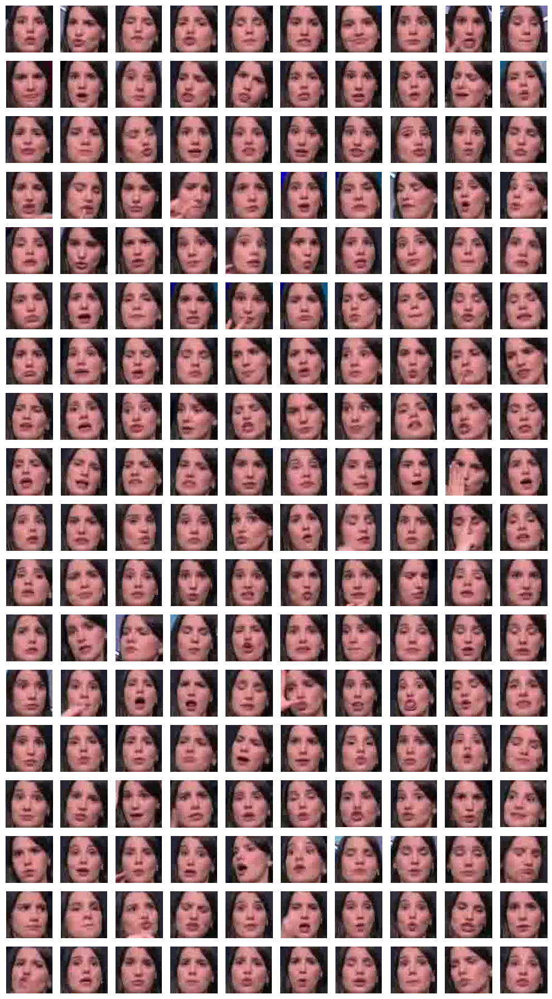

In [41]:
# Intialize empty lists to store the facial embeddings of each person
PNS = []
Mortagua = []
TV_Host = []
Sign_Language_Interpreter = []

# Collect all facial embedding vectors from the 'fer' column of each frame, but only 
for i in range(data.shape[0]):

    # Debate starts at frame 50 and ends at frame 39*60
    if i >= 50  and i <= 39*60 and i%5 == 0: 

        # 4 people on frame
        if len(data.iloc[i]['fer']) == 4: 

            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                fer['filename'] = data.iloc[i]['filename']
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            Mortagua.append(people[0])
            TV_Host.append(people[1])
            PNS.append(people[2])
            Sign_Language_Interpreter.append(people[3])


        # 3 people on frame
        elif len(data.iloc[i]['fer']) == 3:

            # Initialize a empty list to store each person in the frame
            people = []

            # Iterate through each face in the frame 
            for fer in data.iloc[i]['fer']:
                # Add the filename to the face dictionary
                fer['filename'] = data.iloc[i]['filename']
                people.append(fer)

            # Sort the people by the x-coordinate of the bounding box
            people = sorted(people, key=lambda x: x['location'][0])

            # Append the facial embeddings of each person to the corresponding list
            Mortagua.append(people[0])
            PNS.append(people[1])
            Sign_Language_Interpreter.append(people[2])



# Create lists to store the cropped images of each face
cropped_images = []

# Iterate through each person
for person in [PNS, Mortagua, TV_Host, Sign_Language_Interpreter]:

    # Iterate through each face
    for fer in person:
        # Plot frame image
        img = Image.open(os.path.join('be-ps', fer['filename']))

        # Extract the bounding box coordinates
        x = fer['location'][0]
        y = fer['location'][2]
        width = fer['location'][1] - fer['location'][0]
        height = fer['location'][3] - fer['location'][2]

        # Crop the image to the bounding box
        cropped_img = img.crop((x, y, x + width, y + height))

        # Add the cropped image to the list
        cropped_images.append(cropped_img)

    # Determine the number of images and the number of images per row
    num_images = len(cropped_images)
    images_per_row = 10  # Adjust as needed

    # Adjust the number of images to be a multiple of images_per_row
    num_images = (num_images // images_per_row) * images_per_row

    # Determine the number of rows
    num_rows = num_images // images_per_row

    # Create a figure with a subplot for each image
    fig, axs = plt.subplots(num_rows, images_per_row, figsize=(images_per_row, num_rows))  # Adjust size as needed

    # Iterate through each image
    for i, cropped_img in enumerate(cropped_images[:num_images]):
        # Determine the row and column indices of the subplot
        row = i // images_per_row
        col = i % images_per_row

        # Display the cropped image in the corresponding subplot
        axs[row, col].imshow(cropped_img)
        axs[row, col].axis('off')  # Hide axes

    # Display all images
    plt.tight_layout()
    plt.show()

    # Clear the list of cropped images for the next person
    cropped_images.clear()
        

# Success: this approach is valid

- Big bottleneck: we discard frames where only one person appears, which represent 45% of the debate.

- Combining this with the previous one is the key to get the best person identificator througout the debate.